<a href="https://colab.research.google.com/github/MN589/Data-Science-and-ML-Project-Portfolio/blob/main/Applying%20NLP%20for%20Topic%20modelling%20%26%20Sentiment%20Analysis/Applying_NLP_for_topic_modelling_and_sentiment_Analysis.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Applying NLP for topic modelling in a real-life context Project

## **Business context**

The PureGym Group, founded in 2008, has approximately 2 million members and 600 gyms across the world (particularly in the UK, Denmark, and Switzerland). As one of the world’s largest value fitness operators, PureGym appeals to a broad range of customers by offering high-quality, low-cost, and flexible fitness facilities. The company’s customer-centric proposition – affordable membership fees, no fixed-term contracts, and 24/7 access to high-quality gyms – differentiates it from more traditional gyms and elevates it as a market leader within this space.

This focus on the customer is centred on wanting to understand what motivates members to join and what factors influence their behaviours once they have joined. Understanding how to leverage innovative technology to influence, improve, and simplify their experience allows PureGym to foster an open, welcoming, and diverse environment for its members while maintaining the value proposition that PureGym is built upon.

With the shift in focus to value-for-money memberships across the gym industry, PureGym seeks to achieve its mission of ‘inspiring a healthier world by providing members with affordable access to the benefits being healthy can offer’.


<br></br>

## **Objective**

In this project, you will have analysed PureGym's review data to uncover key drivers that provide actionable insights for enhancing customer experience.

In the Notebook, you will:

- Use two data sets containing customer reviews from Google and Trustpilot.
- Perform basic level analysis by finding the frequently used words in both data sets.
- Generate a wordcloud to visualise the most frequently used words in the reviews.
- Apply BERTopic for topic modelling, keeping track of gym locations, to identify common topics and words in the negative reviews.
- Identify the locations that have the most negative reviews.
- Use the built-in visualisation functions in BERTopic to cluster and visually represent the topics and words in these reviews, thereby helping to identify specific themes from the reviews.
- Conduct a comparison with Gensim’s LDA model to validate the topic modelling results.
- Perform emotion analysis to identify the emotions associated with customer reviews.
- Filter out angry reviews and apply BERTopic to discover prevalent topics and words being discussed these negative reviews.
- Leverage the multi-purpose capability of the state-of-the-art Falcon-7b-instruct model, with the help of prompts, to identify top topics in each review.
- Use a different prompt with the Falcon-7b-instruct model to further generate suggestions for improvements for PureGym, based on the top topics identified from the negative reviews.


You will also write a report summarising the results of your findings and recommendations.



In [ ]:
#Import Libraries and Packages
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import pandas as pd
import scipy
import seaborn as sns

from wordcloud import WordCloud, STOPWORDS
import nltk
from nltk.corpus import stopwords
nltk.download('stopwords')
nltk.download('punkt')
nltk.download('punkt_tab')

from nltk.tokenize import word_tokenize
from nltk.tokenize import RegexpTokenizer
import re
from collections import Counter
from nltk.util import ngrams

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.
[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt.zip.
[nltk_data] Downloading package punkt_tab to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt_tab.zip.


In [ ]:
! pip install langdetect

from langdetect import detect

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 981.5/981.5 kB 25.8 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for langdetect: filename=langdetect-1.0.9-py3-none-any.whl size=993223 sha256=fa9736c8b27ecb18d954b51e77c023af240489dd9e2d624098f41ab9f292c70f
  Stored in directory: /root/.cache/pip/wheels/0a/f2/b2/e5ca405801e05eb7c8ed5b3b4bcf1fcabcd6272c167640072e
Successfully built langdetect


In [ ]:
#Upload Google and Trusted Pilot datasets:
from google.colab import files
files.upload()

Saving Google_12_months.csv to Google_12_months.csv
Saving Trustpilot_12_months.csv to Trustpilot_12_months.csv


{'Google_12_months.csv': b'Customer Name,SurveyID for external use (e.g. tech support),Club\'s Name,Social Media Source,Creation Date,Comment,Overall Score\r\n**,ekkt2vyxtkwrrrfyzc5hz6rk,Leeds City Centre North,Google Reviews,09/05/2024 23:49,,4\r\n**,e9b62vyxtkwrrrfyzc5hz6rk,Cambridge Leisure Park,Google Reviews,09/05/2024 22:48,Too many students from two local colleges go her leave rubbish in changing rooms and sit there like there in a canteen. Been going here for 5 years will cancel my membership and go to gym group. This gym is disgusting students hanging around machines and messing around like there at school. Too over crowded.( And their ceo supports the genocide of civilians by Israel). Disgusting people!!,1\r\n**,e2dkxvyxtkwrrrfyzc5hz6rk,London Holborn,Google Reviews,09/05/2024 22:08,"Best range of equipment, cheaper than regular gyms. very professional and friendly staff that makes your gym your second home",5\r\n**,e3tfxvyxtkwrrrfyzc5hz6rk,Cheshunt Brookfield Shopping Park,G

## DataSet Review:

### Google Reviews Dataset: Review and Cleaning

In [ ]:
# Google csv Dataset
google_df = pd.read_csv('Google_12_months.csv', encoding='ISO-8859-1')

# Display Google csv Dataset
google_df.head()

,Customer Name,SurveyID for external use (e.g. tech support),Club's Name,Social Media Source,Creation Date,Comment,Overall Score
0,**,ekkt2vyxtkwrrrfyzc5hz6rk,Leeds City Centre North,Google Reviews,09/05/2024 23:49,NaN,4
1,**,e9b62vyxtkwrrrfyzc5hz6rk,Cambridge Leisure Park,Google Reviews,09/05/2024 22:48,Too many students from two local colleges go h...,1
2,**,e2dkxvyxtkwrrrfyzc5hz6rk,London Holborn,Google Reviews,09/05/2024 22:08,"Best range of equipment, cheaper than regular ...",5
3,**,e3tfxvyxtkwrrrfyzc5hz6rk,Cheshunt Brookfield Shopping Park,Google Reviews,09/05/2024 21:58,"Good gym when its not busy, tend to get too b...",4
4,**,edkrxvyxtkwrrrfyzc5hz6rk,Bristol Union Gate,Google Reviews,09/05/2024 21:48,"(current member)\n\nGym is quite dirty, more o...",1


In [ ]:
google_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 23250 entries, 0 to 23249
Data columns (total 7 columns):
 #   Column                                         Non-Null Count  Dtype 
---  ------                                         --------------  ----- 
 0   Customer Name                                  23250 non-null  object
 1   SurveyID for external use (e.g. tech support)  23250 non-null  object
 2   Club's Name                                    23250 non-null  object
 3   Social Media Source                            23250 non-null  object
 4   Creation Date                                  23250 non-null  object
 5   Comment                                        13898 non-null  object
 6   Overall Score                                  23250 non-null  int64 
dtypes: int64(1), object(6)
memory usage: 1.2+ MB


In [ ]:
# Redundant Columns to be Dropped:
columns_to_drop = ['Customer Name','SurveyID for external use (e.g. tech support)', 'Social Media Source']
google_df = google_df.drop(columns=columns_to_drop)

In [ ]:
# Check for for duplicated Rows, null values and datatypes:
print(google_df.duplicated().sum())

753


In [ ]:
# Drop Duplicate Rows:
google_df.drop_duplicates()

,Club's Name,Creation Date,Comment,Overall Score
0,Leeds City Centre North,09/05/2024 23:49,NaN,4
1,Cambridge Leisure Park,09/05/2024 22:48,Too many students from two local colleges go h...,1
2,London Holborn,09/05/2024 22:08,"Best range of equipment, cheaper than regular ...",5
3,Cheshunt Brookfield Shopping Park,09/05/2024 21:58,"Good gym when its not busy, tend to get too b...",4
4,Bristol Union Gate,09/05/2024 21:48,"(current member)\n\nGym is quite dirty, more o...",1
...,...,...,...,...
23245,Sheffield Millhouses,07/03/2022 20:36,Chiara's class is great fun and she is a fab i...,5
23246,Sheffield Millhouses,07/03/2022 20:36,Perfect gym,5
23247,Sheffield Millhouses,07/03/2022 20:36,Loved the pump class today,4
23248,Sheffield Millhouses,07/03/2022 20:36,Excellent gym with very friendly staff. All th...,5


In [ ]:
#Check number of null values in the
google_df.isnull().sum()

#Drop rows with missing values in the comment section
google_df = google_df.dropna(subset=['Comment'])

In [ ]:
# Clean Text in for the comment column for the Google Dataset
def clean_text_for_lang_detection(text):
    if not isinstance(text, str):
        return ""
    text = re.sub(r"http\S+|www\S+|https\S+", "", text)
    text = re.sub(r"[^a-zA-Z\s]", "", text)
    text = re.sub(r"\s+", " ", text).strip()
    return text

In [ ]:
#Detect the Language:
def detect_language(text):
        try:
            return detect(text)
        except:
            return "error"

In [ ]:
import re

# Clean the Comment Column before language detection:
google_df['Comment'] = google_df['Comment'].apply(clean_text_for_lang_detection)

In [ ]:
# Detect language:
google_df['Language'] = google_df['Comment'].apply(detect_language)

In [ ]:
google_df.head()

,Club's Name,Creation Date,Comment,Overall Score,Language
1,Cambridge Leisure Park,09/05/2024 22:48,Too many students from two local colleges go h...,1,en
2,London Holborn,09/05/2024 22:08,Best range of equipment cheaper than regular g...,5,en
3,Cheshunt Brookfield Shopping Park,09/05/2024 21:58,Good gym when its not busy tend to get too bus...,4,en
4,Bristol Union Gate,09/05/2024 21:48,current member Gym is quite dirty more often t...,1,en
5,"209 - Slagelse, Jernbanegade",09/05/2024 21:36,Kom og betalte for en prvetime i centret Fik b...,1,da


In [ ]:
# Only keep reviews that are in English
google_df = google_df[google_df['Language'] == 'en']

## Trustpilot Dataset Review and Cleaning

In [ ]:
# Trustedpilot csv Dataset
trustpilot_df = pd.read_csv('Trustpilot_12_months.csv', encoding='ISO-8859-1')

# Display Trustedpilot csv Dataset:
trustpilot_df.head()

,Review ID,Review Created (UTC),Review Consumer User ID,Review Title,Review Content,Review Stars,Source Of Review,Review Language,Domain URL,Webshop Name,Business Unit ID,Tags,Company Reply Date (UTC),Location Name,Location ID
0,663d40378de0a14c26c2f63c,09/05/2024 23:29,663d4036d5fa24c223106005,A very good environment,A very good environment,5,AFSv2,en,http://www.puregym.com,PureGym UK,508df4ea00006400051dd7b1,NaN,10/05/2024 08:12,Solihull Sears Retail Park,7b03ccad-4a9d-4a33-9377-ea5bba442dfc
1,663d3c101ccfcc36fb28eb8c,09/05/2024 23:11,5f5e3434d53200fa6ac57238,I love to be part of this gym,I love to be part of this gym. Superb value fo...,5,AFSv2,en,http://www.puregym.com,PureGym UK,508df4ea00006400051dd7b1,NaN,10/05/2024 08:13,Aylesbury,612d3f7e-18f9-492b-a36f-4a7b86fa5647
2,663d375859621080d08e6198,09/05/2024 22:51,57171ba90000ff000a18f905,Extremely busy,"Extremely busy, no fresh air.",1,AFSv2,en,http://www.puregym.com,PureGym UK,508df4ea00006400051dd7b1,NaN,NaN,Sutton Times Square,0b78c808-f671-482b-8687-83468b7b5bc1
3,663d4fa1f25670a3339ccf6d,09/05/2024 22:35,663d4fa0d5fa24251d1068e7,Great vibes,"Great vibes, fantastic gym",5,AFSv2,en,http://www.puregym.com,PureGym UK,508df4ea00006400051dd7b1,NaN,NaN,London Finchley,bc3a9a8c-defe-47b3-8ee6-f73a03b7447e
4,663d3251d8367b7b3c4ace64,09/05/2024 22:30,60c20598384d84001a4250de,Everything it needs to be,"Clean, well managed, classes are good.",5,AFSv2,en,http://www.puregym.com,PureGym UK,508df4ea00006400051dd7b1,NaN,10/05/2024 08:14,Crayford,9ce470b7-57df-4533-af2f-c539422fed14


In [ ]:
trustpilot_df.info()

print(trustpilot_df.duplicated().sum())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 16673 entries, 0 to 16672
Data columns (total 15 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   Review ID                 16673 non-null  object 
 1   Review Created (UTC)      16673 non-null  object 
 2   Review Consumer User ID   16673 non-null  object 
 3   Review Title              16673 non-null  object 
 4   Review Content            16673 non-null  object 
 5   Review Stars              16673 non-null  int64  
 6   Source Of Review          16673 non-null  object 
 7   Review Language           16673 non-null  object 
 8   Domain URL                16673 non-null  object 
 9   Webshop Name              16673 non-null  object 
 10  Business Unit ID          16673 non-null  object 
 11  Tags                      0 non-null      float64
 12  Company Reply Date (UTC)  16164 non-null  object 
 13  Location Name             11323 non-null  object 
 14  Locati

In [ ]:
# Drop Redundant Columns in the TrustedPilot Dataset:
columns_to_drop_1 = ['Review ID','Source Of Review','Domain URL','Webshop Name','Business Unit ID', 'Tags','Location ID','Review Consumer User ID']
trustpilot_df = trustpilot_df.drop(columns=columns_to_drop_1)

In [ ]:
# Number of Duploicated rows in the Trustpilot DataFrane:
print(trustpilot_df.duplicated().sum())

7


In [ ]:
# Remove duplicates in the Trustpilot
trustpilot_df.drop_duplicates(inplace=True)

In [ ]:
#Check number of null values in the
trustpilot_df.isnull().sum()

#Drop rows with missing values in the comment section
trustpilot_df =trustpilot_df.dropna(subset=['Location Name'])

In [ ]:
# Only keep Data that is in the UK and the review content is in English.
trustpilot_df = trustpilot_df[trustpilot_df['Review Language'] == 'en']

## Initial Data Investigation

In [ ]:
google_df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 11861 entries, 1 to 23248
Data columns (total 5 columns):
 #   Column         Non-Null Count  Dtype 
---  ------         --------------  ----- 
 0   Club's Name    11861 non-null  object
 1   Creation Date  11861 non-null  object
 2   Comment        11861 non-null  object
 3   Overall Score  11861 non-null  int64 
 4   Language       11861 non-null  object
dtypes: int64(1), object(4)
memory usage: 556.0+ KB


In [ ]:
trustpilot_df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 11285 entries, 0 to 16672
Data columns (total 7 columns):
 #   Column                    Non-Null Count  Dtype 
---  ------                    --------------  ----- 
 0   Review Created (UTC)      11285 non-null  object
 1   Review Title              11285 non-null  object
 2   Review Content            11285 non-null  object
 3   Review Stars              11285 non-null  int64 
 4   Review Language           11285 non-null  object
 5   Company Reply Date (UTC)  10995 non-null  object
 6   Location Name             11285 non-null  object
dtypes: int64(1), object(6)
memory usage: 705.3+ KB


In [ ]:
#find unique locations in the Google dataset:
google_df_locations=google_df["Club's Name"].unique()
google_df_locations = google_df_locations.tolist()
print(len(google_df_locations))

455


In [ ]:
#find unique locations in the Trustedpilot dataset:
trustpilot_df_locations=trustpilot_df["Location Name"].unique()
trustpilot_df_locations = trustpilot_df_locations.tolist()
print(len(trustpilot_df_locations))

376


In [ ]:
#find if the locations overlap
intersection_of_locations=[e for e in trustpilot_df_locations if e in google_df_locations]
print(len(intersection_of_locations))

310


In [ ]:
# Function to clean and display Trigram WordCloud display for the reviews:
def word_cloud_display(df, key):
    top_number_of_results = 100
    all_reviews = df[key].str.lower().str.cat(sep=' ')
    all_text = re.sub(r'[^A-Za-z\s]', ' ', all_reviews)
    stop_words = set(stopwords.words('english'))
    word_tokens = word_tokenize(all_text)
    filtered_all_reviews = [w for w in word_tokens if w not in stop_words and len(w) > 2 and not w.isnumeric()]

    # Create Trigrams
    trigrams = list(ngrams(filtered_all_reviews, 3))
    trigram_strings = [' '.join(tri) for tri in trigrams]
    trigram_distribution = nltk.FreqDist(trigram_strings)
    trigram_freq_df = pd.DataFrame(trigram_distribution.most_common(top_number_of_results),
                                   columns=['Trigram', 'Frequency'])

    # Plot top trigrams
    plt.figure(figsize=(12, 6))
    sns.set_style("whitegrid")
    sns.barplot(x="Frequency", y="Trigram", data=trigram_freq_df.head(10), )
    plt.title("Top 10 Trigrams")
    plt.xlabel("Trigrams")
    plt.ylabel("Frequency")
    plt.show()

    # WordCloud for trigrams
    plt.figure(figsize=(10, 10))
    wc = WordCloud(background_color='black', max_words=1000, max_font_size=50)
    wc.generate(' '.join(trigram_strings))
    plt.imshow(wc)
    plt.axis('off')
    plt.show()

## Trigram Word Cloud Display  & Trigram Frequency Chart for the Datasets:

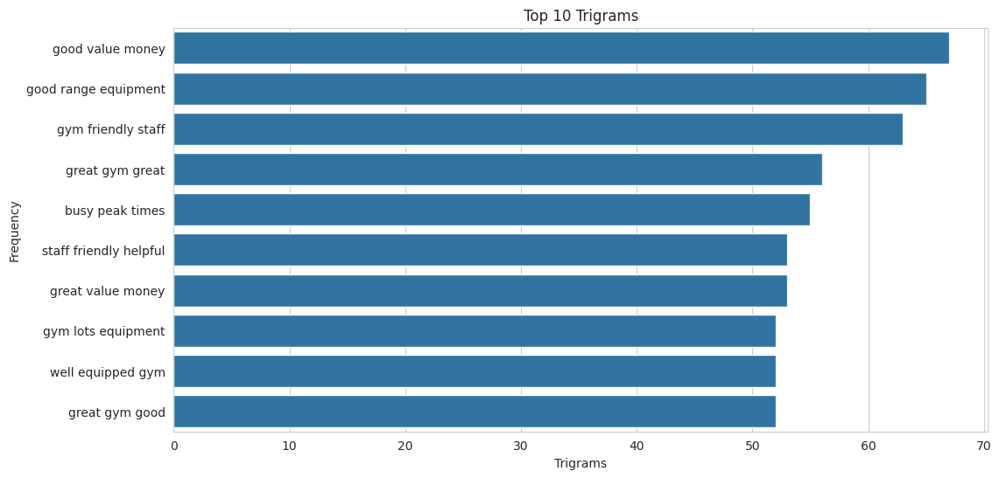

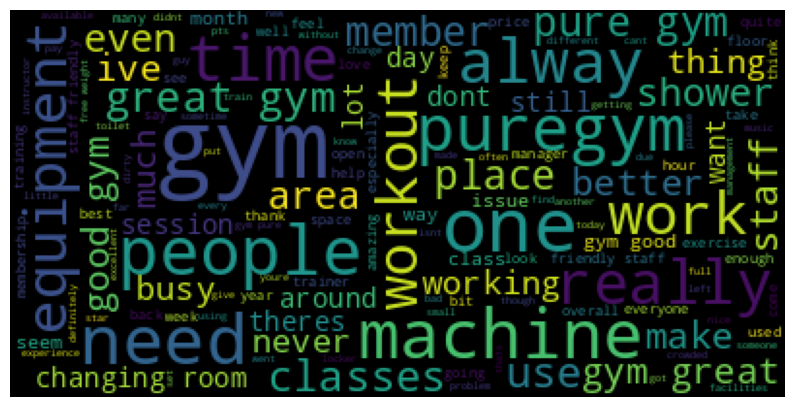

In [ ]:
# Trigram Word Cloud Display & Trigram Frequency Chart for the Google Review Dataset:
word_cloud_display(google_df,'Comment')

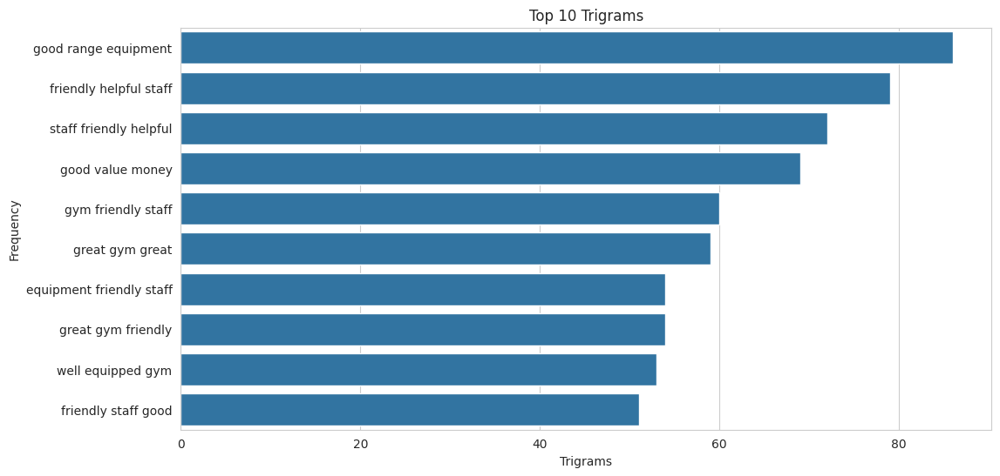

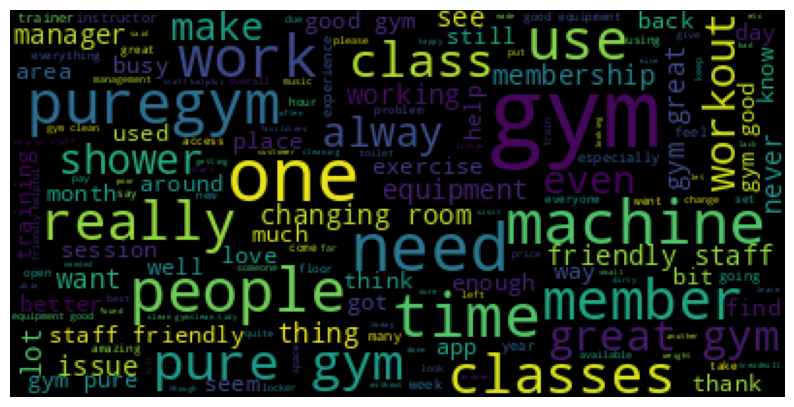

In [ ]:
# Trigram Word Cloud Display & Trigram Frequency Chart for the Trustpilot Dataset:
word_cloud_display(trustpilot_df,'Review Content')

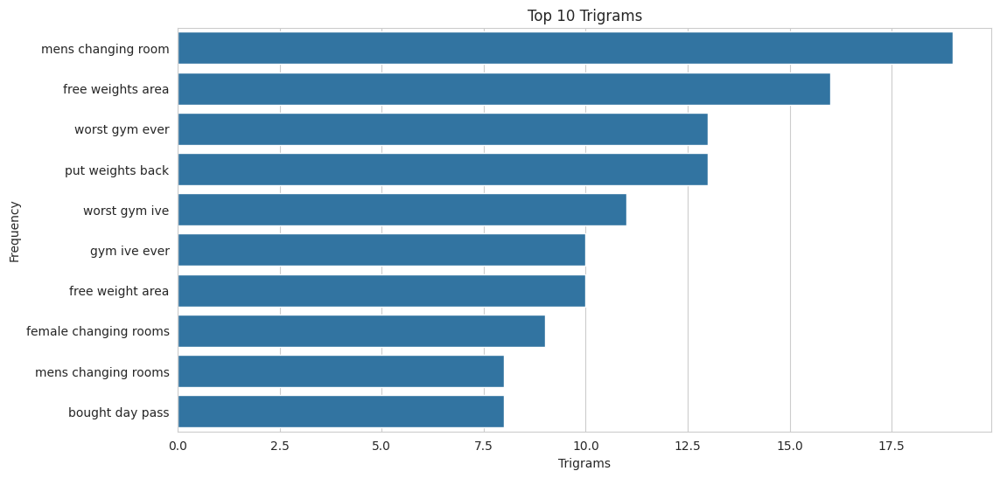

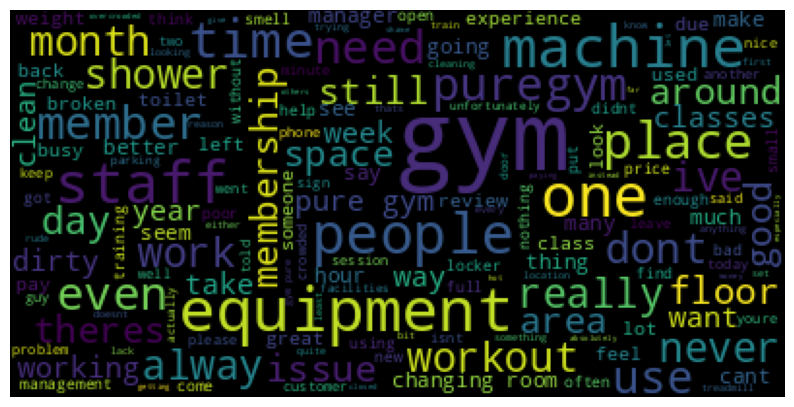

In [ ]:
# Create a new Dataframe for the google review with an overall score of less than 3
bad_reviews_google = google_df[google_df['Overall Score'] < 3]

# Trigram Word Cloud Display & Trigram Frequency Chart for the badreviews in the Google Dataset
word_cloud_display(bad_reviews_google,'Comment')

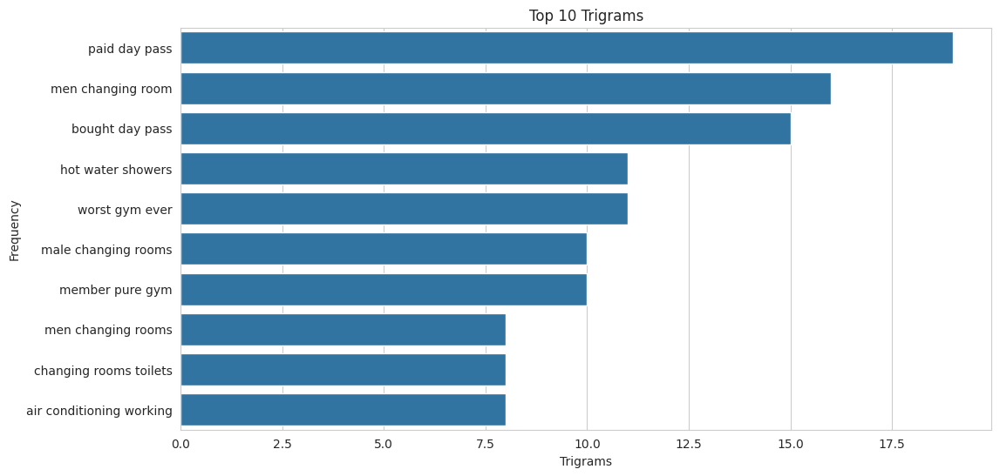

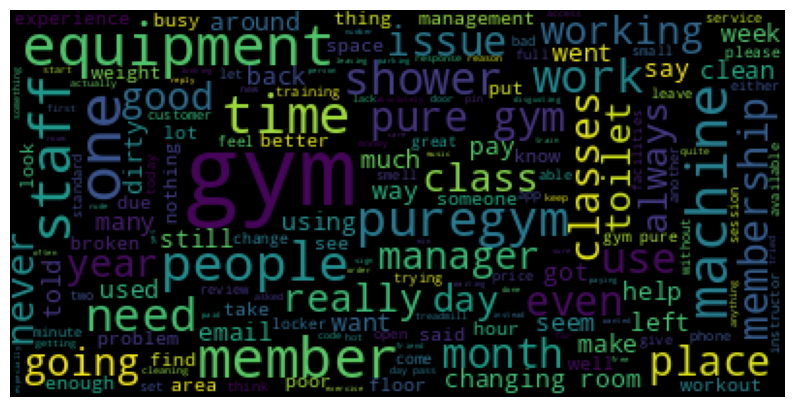

In [ ]:
# Create a new Dataframe for the Trustpilot reviews with reviews stars less than 3
bad_reviews_trustpilot = trustpilot_df[trustpilot_df['Review Stars'] < 3]

# Trigram Word Cloud Display & Trigram Frequency Chart for the badreviews in the Trustpilot Dataset
word_cloud_display(bad_reviews_trustpilot,'Review Content')

## Conducting Initial Topic Modelling - Using BERT

In [ ]:
from transformers import pipeline

In [ ]:
!pip install bertopic

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 150.6/150.6 kB 5.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 3.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 119.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 96.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 58.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 831.0 kB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 4.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 14.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 7.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 6.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 43.3 MB/s eta 0:00:00
  Attempting uninstall: nvidia-nvjitlink-cu12
    Found existing installation: nvidia-nvjitlink-cu12 12.5.82
    Uninstal

In [ ]:
from bertopic import BERTopic

In [ ]:
# Filter the Badreviews in the Google Dataset that are in locations common in both Google and Trustpilot Datasets
bad_google_reviews__in_both_locations_df = bad_reviews_google[bad_reviews_google["Club's Name"].isin(intersection_of_locations)]
bad_google_reviews__in_both_locations_df["Comment"] = bad_google_reviews__in_both_locations_df["Comment"].astype(str)
bad_google_reviews_list =bad_google_reviews__in_both_locations_df["Comment"].to_list()
print(bad_google_reviews_list[0:9])

['Too many students from two local colleges go her leave rubbish in changing rooms and sit there like there in a canteen Been going here for years will cancel my membership and go to gym group This gym is disgusting students hanging around machines and messing around like there at school Too over crowded And their ceo supports the genocide of civilians by Israel Disgusting people', 'current member Gym is quite dirty more often than not theres no soap in the bathroom There is zero airflow in the gym its like a sauna in here Also the gym is often overcrowded anytime after pm The only good thing about this gym is the location and the bring your buddy thing', 'This gym is way too hot to even workout in There are no windows open and the AC barely works The staff are no where near friendly they are always rude especially the men Just because you have clients doesnt mean you dont work here', 'No access for wc Empty and no assistance to gain access my fault as forgot my pin but didnt see stay 

In [ ]:
# Filter the Badreviews in the Trustpilot Dataset that are in locations common in both Google and Trustpilot Datasets
bad_reviews_trustpilot_in_both_locations_df = bad_reviews_trustpilot[bad_reviews_trustpilot["Location Name"].isin(intersection_of_locations)]
bad_reviews_trustpilot_in_both_locations_df["Review Content"]= bad_reviews_trustpilot_in_both_locations_df["Review Content"].astype(str)
bad_reviews_trustpilot_list =bad_reviews_trustpilot_in_both_locations_df["Review Content"].to_list()
print(bad_reviews_trustpilot_list[0:9])

['Extremely busy, no fresh air.', 'The men\x92s changing rooms smell bad. They need a deep clean with some sort of smell management in the toilets. It is not pleasant and put me off using the facilities at all. The regular cleaning is not enough to get on top of this.', 'No one was cleaning the equipment after use. Cleaning stations were hidden away in corners. Empty cans and bottles were lying on the floor. People were not using the equipment properly, and there were no staff around to ensure people were not going to be injured.', 'Not the best experience at 7am on a week day. Bought a day pass but only received the receipt and no access code. Walked in with a delivery guy but couldn\x92t find anyone who works at the gym to help me. Walked like three round through the gym without result.   After that I tried to leave but was not possible to leave as I needed a code for that again.   If you have some money to spare, I would urge everyone to pay a bit more to get some service at another

In [ ]:
all_bad_reviews_list = bad_google_reviews_list + bad_reviews_trustpilot_list

In [ ]:
all_bad_reviews_list[0]

'Too many students from two local colleges go her leave rubbish in changing rooms and sit there like there in a canteen Been going here for years will cancel my membership and go to gym group This gym is disgusting students hanging around machines and messing around like there at school Too over crowded And their ceo supports the genocide of civilians by Israel Disgusting people'

In [ ]:
# Clean and preprocess the All bad reviews list
all_bad_reviews_list_clean = []
for review in all_bad_reviews_list:
  if review is not None and review != "nan":
    review = review.lower()
    review = re.sub('[^A-Za-z]+', ' ', review)

    stop_words = set(stopwords.words('english'))
    word_tokens = word_tokenize(review)

    for w in word_tokens:
      if w in stop_words:
        review = review.replace(" " + w + " ", " ")
    all_bad_reviews_list_clean.append(review)

In [ ]:
print(all_bad_reviews_list_clean)

['too many students two local colleges go leave rubbish changing rooms sit like canteen going years cancel membership go gym group gym disgusting students hanging around machines messing around like school crowded ceo supports genocide civilians israel disgusting people', 'current member gym quite dirty often theres soap bathroom zero airflow gym like sauna also gym often overcrowded anytime pm good thing gym location bring buddy thing', 'this gym way hot even workout windows open ac barely works staff near friendly always rude especially men clients doesnt mean dont work here', 'no access wc empty assistance gain access fault forgot pin didnt see stay enable assistance', 'after gym year im finally leaving im gutted staff pts lovely cant stand overcrowded gym hours day lack equipment relation st james puregym going closing june even new upgrade eldon cant see going work gym already crowded dont think bit extra equipment help mention hot times year cant understand need heating gym youre

In [ ]:
model = BERTopic(verbose=True)
model.fit(all_bad_reviews_list_clean)
topic, probabilities = model.transform(all_bad_reviews_list_clean)

2025-04-15 20:54:19,774 - BERTopic - Embedding - Transforming documents to embeddings.
/usr/local/lib/python3.11/dist-packages/huggingface_hub/utils/_auth.py:94: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


modules.json:   0%|          | 0.00/349 [00:00<?, ?B/s]

config_sentence_transformers.json:   0%|          | 0.00/116 [00:00<?, ?B/s]

README.md:   0%|          | 0.00/10.5k [00:00<?, ?B/s]

sentence_bert_config.json:   0%|          | 0.00/53.0 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/612 [00:00<?, ?B/s]

Xet Storage is enabled for this repo, but the 'hf_xet' package is not installed. Falling back to regular HTTP download. For better performance, install the package with: `pip install huggingface_hub[hf_xet]` or `pip install hf_xet`


model.safetensors:   0%|          | 0.00/90.9M [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/350 [00:00<?, ?B/s]

vocab.txt:   0%|          | 0.00/232k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/466k [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/112 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/190 [00:00<?, ?B/s]

Batches:   0%|          | 0/122 [00:00<?, ?it/s]

2025-04-15 20:55:59,299 - BERTopic - Embedding - Completed ✓
2025-04-15 20:55:59,300 - BERTopic - Dimensionality - Fitting the dimensionality reduction algorithm
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
2025-04-15 20:56:39,313 - BERTopic - Dimensionality - Completed ✓
2025-04-15 20:56:39,314 - BERTopic - Cluster - Start clustering the reduced embeddings
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_

Batches:   0%|          | 0/122 [00:00<?, ?it/s]

2025-04-15 20:57:57,232 - BERTopic - Dimensionality - Reducing dimensionality of input embeddings.
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
2025-04-15 20:57:57,248 - BERTopic - Dimensionality - Completed ✓
2025-04-15 20:57:57,249 - BERTopic - Clustering - Approximating new points with `hdbscan_model`
2025-04-15 20:57:57,456 - BERTopic - Cluster - Completed ✓


In [ ]:
model.get_topic_freq().head(10)

,Topic,Count
6,-1,1670
2,0,185
9,1,180
3,2,148
10,3,147
19,4,115
12,5,108
18,6,96
21,7,81
27,8,79


In [ ]:
model.get_topic(0)

[('air', np.float64(0.06547900035169829)),
 ('conditioning', np.float64(0.04092997917697904)),
 ('hot', np.float64(0.031516065920848386)),
 ('ac', np.float64(0.031361577074831726)),
 ('aircon', np.float64(0.029242348369162324)),
 ('summer', np.float64(0.025246649639395123)),
 ('con', np.float64(0.0249832340430911)),
 ('heat', np.float64(0.022164211600274448)),
 ('working', np.float64(0.01903245421116074)),
 ('warm', np.float64(0.01778531336400543))]

In [ ]:
model.get_topic(1)

[('machines', np.float64(0.06003309283335238)),
 ('machine', np.float64(0.03683840970635838)),
 ('broken', np.float64(0.035450552023370684)),
 ('equipment', np.float64(0.0328903587304913)),
 ('cable', np.float64(0.031079063233766146)),
 ('order', np.float64(0.02816463854918878)),
 ('fix', np.float64(0.020781636526179263)),
 ('enough', np.float64(0.02004360869743678)),
 ('one', np.float64(0.019751224673284853)),
 ('rowing', np.float64(0.018646121096881903))]

In [ ]:
model.visualize_topics()

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


In [ ]:
model.visualize_barchart()

In [ ]:
model.visualize_heatmap()

In [ ]:
hierarchical_topics = model.hierarchical_topics(all_bad_reviews_list_clean)
model.visualize_hierarchy(hierarchical_topics=hierarchical_topics)

100%|██████████| 49/49 [00:00<00:00, 283.84it/s]


The dendrogram above provides us with a hierarchical clustering of topics raised in the merged bad reviews from both the trustpilot and Google reviews Datasets.

I've noted a brief description of the themes of the  highligheted topics in the hierarchical cluster below:


- The first cluster topic is complaints regarding the showers, among the complaints are cold showers, fungus in the shower area.

- The second cluster topic is about complaints regarding overcrowding and a very busy gym.

- The third cluster topic is on issues with equipment in the gym, examples include broken equipment such as machines,benches, water yanga machine and weights everywhere,

- The fourth cluster topic  is on issues with cleanliness and smell, issues highlighted include poor toilet sanitation,

- The fifth cluster topic  is on issues with aircon and a smell coming from the ventilation

- The sixth cluster topic is on issues with regards to loud noise

- The seventh cluster topic  is on issues with regards to the car park

- The eight cluster topic  is on issues regarding memberships such as joining fees, membership emails and issues with cancellation

- The  nineth cluster topic is regarding staff and issues with regards to poor customer interactions with issues such as rudeness

- The tenth cluster topic is with regards to issues with entrance with regards to pincode and door

## Performing further data Investigation

In [ ]:
# Top 20 Locations with Negative reviews from the Google_Reviews Dataset
bad_reviews_google_by_location= bad_reviews_google.copy()
bad_reviews_google_by_location = bad_reviews_google_by_location [["Club's Name"]]
bad_reviews_google_by_location = bad_reviews_google_by_location.dropna()
bad_reviews_google_by_location["Club's Name"] = bad_reviews_google_by_location["Club's Name"].astype(str)
bad_reviews_google_by_location = bad_reviews_google_by_location.groupby(["Club's Name"])["Club's Name"].count().reset_index(name="Count_Negative_reviews_Google")
bad_reviews_google_by_location_sorted = bad_reviews_google_by_location.sort_values(by="Count_Negative_reviews_Google", ascending=False)
bad_reviews_google_by_location_sorted.head(20)

,Club's Name,Count_Negative_reviews_Google
248,London Stratford,59
259,London Woolwich,26
205,London Canary Wharf,26
215,London Enfield,25
250,London Swiss Cottage,22
240,London Palmers Green,22
232,London Leytonstone,21
60,Birmingham City Centre,20
73,Bradford Thornbury,19
281,New Barnet,18


In [ ]:
# Top 20 Locations with Negative reviews from the Trustedpilot_Reviews Dataset
bad_reviews_trustpilot_by_location= bad_reviews_trustpilot.copy()
bad_reviews_trustpilot_by_location = bad_reviews_trustpilot_by_location [["Location Name"]]
bad_reviews_trustpilot_by_location = bad_reviews_trustpilot_by_location.dropna()
bad_reviews_trustpilot_by_location["Location Name"] = bad_reviews_trustpilot_by_location["Location Name"].astype(str)
bad_reviews_trustpilot_by_location = bad_reviews_trustpilot_by_location.groupby(["Location Name"])["Location Name"].count().reset_index(name="Count_Negative_reviews_trustpilot")
bad_reviews_trustpilot_by_location_sorted = bad_reviews_trustpilot_by_location.sort_values(by="Count_Negative_reviews_trustpilot", ascending=False)
bad_reviews_trustpilot_by_location_sorted.head(20)

,Location Name,Count_Negative_reviews_trustpilot
155,Leicester Walnut Street,50
0,345,45
186,London Enfield,23
219,London Stratford,22
58,Burnham,20
171,London Bermondsey,18
199,London Ilford,18
188,London Finchley,16
215,London Seven Sisters,16
233,Maidenhead,16


Reviewing the Top 20 locations with bad reviews for the Google and Trustpilot Datasets, there are common locations listed in the top 20 for both datasets, but not an exact match, with only 7 matching locations out of 20.

- London Stratford
- London Enfield
- London Swiss Cottage
- Birmingham City Centre
- New Barnet
- London Hayes
- London Bermondsey

In [ ]:
merged_location_bad_reviews_count_df = pd.merge(bad_reviews_google_by_location_sorted, bad_reviews_trustpilot_by_location_sorted, how="left", left_on="Club's Name", right_on="Location Name")
merged_location_bad_reviews_count_df = merged_location_bad_reviews_count_df.dropna()
merged_location_bad_reviews_count_df.drop("Club's Name", axis=1, inplace=True)
merged_location_bad_reviews_count_df['Total_Count_Negative_reviews'] = merged_location_bad_reviews_count_df['Count_Negative_reviews_Google'] + merged_location_bad_reviews_count_df['Count_Negative_reviews_trustpilot']
merged_location_bad_reviews_count_df_sorted = merged_location_bad_reviews_count_df.sort_values(by="Total_Count_Negative_reviews", ascending=False)
merged_location_bad_reviews_count_df_sorted = merged_location_bad_reviews_count_df_sorted[["Location Name", "Count_Negative_reviews_Google","Count_Negative_reviews_trustpilot","Total_Count_Negative_reviews" ]]
merged_location_bad_reviews_count_df_sorted.head(30)

,Location Name,Count_Negative_reviews_Google,Count_Negative_reviews_trustpilot,Total_Count_Negative_reviews
0,London Stratford,59,22.0,81.0
59,Leicester Walnut Street,11,50.0,61.0
3,London Enfield,25,23.0,48.0
4,London Swiss Cottage,22,15.0,37.0
7,Birmingham City Centre,20,14.0,34.0
15,London Seven Sisters,17,16.0,33.0
20,London Bermondsey,15,18.0,33.0
8,Bradford Thornbury,19,14.0,33.0
14,London Hayes,17,16.0,33.0
2,London Canary Wharf,26,6.0,32.0


In [ ]:
# Location of the top 30 gyms with the most negative reviews
top_30_neg_locations = [
    "London Stratford", "Leicester Walnut Street", "London Enfield", "London Swiss Cottage",
    "Birmingham City Centre", "London Seven Sisters", "London Bermondsey", "New Barnet",
    "London Hayes", "Bradford Thornbury", "London Canary Wharf", "Walsall Crown Wharf",
    "Burnham", "London Finchley", "London Hammersmith Palais", "London Muswell Hill",
    "Nottingham Colwick", "Birmingham Beaufort Park", "London Hoxton", "Wakefield",
    "Basildon", "Maidenhead", "London Holborn", "London Leytonstone", "London Park Royal",
    "London Bromley", "London Beckton", "Manchester Exchange Quay", "Sutton Times Square",
    "Leicester St Georges Way"
]

In [ ]:
# Combine the bad review datasets
combined_bad_reviews = pd.merge(bad_google_reviews__in_both_locations_df, bad_reviews_trustpilot_in_both_locations_df, how="left", left_on="Club's Name", right_on="Location Name")

#Create subset Dataframe for the top 30 gyms with the most negative reviews
top_30_neg_locations_df = combined_bad_reviews[combined_bad_reviews["Club's Name"].isin(top_30_neg_locations)]

In [ ]:
top_30_neg_locations_df.head()

,Club's Name,Creation Date,Comment,Overall Score,Language,Review Created (UTC),Review Title,Review Content,Review Stars,Review Language,Company Reply Date (UTC),Location Name
8,New Barnet,09/05/2024 20:16,This gym is way too hot to even workout in The...,2,en,30/04/2024 11:45,A lot of equipment is broken and has,A lot of equipment is broken and has been for ...,2.0,en,10/05/2024 12:26,New Barnet
9,New Barnet,09/05/2024 20:16,This gym is way too hot to even workout in The...,2,en,31/03/2024 01:41,Far too busy and not all equipment in,Far too busy and not all equipment in working ...,2.0,en,03/04/2024 19:34,New Barnet
10,New Barnet,09/05/2024 20:16,This gym is way too hot to even workout in The...,2,en,24/03/2024 14:17,It can be hit or miss with these gyms.,It can be hit or miss with these gyms. I rejo...,1.0,en,29/03/2024 13:56,New Barnet
11,New Barnet,09/05/2024 20:16,This gym is way too hot to even workout in The...,2,en,13/02/2024 14:36,I get this is a budget gym but wow such,I get this is a budget gym but wow such a dirt...,2.0,en,27/02/2024 16:04,New Barnet
12,New Barnet,09/05/2024 20:16,This gym is way too hot to even workout in The...,2,en,10/02/2024 10:30,Need to attend to broken equipment,Yanga Sports Water machine out of order again....,1.0,en,16/02/2024 16:34,New Barnet


In [ ]:
# Convert Google Review in the Comment column in the merged data frame to a list
top_30_neg_locations_df['Comment'] = top_30_neg_locations_df['Comment'].astype(str)
bad_google_reviews_top_30_locations = top_30_neg_locations_df['Comment'].to_list()
print(bad_google_reviews_top_30_locations[0:9])

['This gym is way too hot to even workout in There are no windows open and the AC barely works The staff are no where near friendly they are always rude especially the men Just because you have clients doesnt mean you dont work here', 'This gym is way too hot to even workout in There are no windows open and the AC barely works The staff are no where near friendly they are always rude especially the men Just because you have clients doesnt mean you dont work here', 'This gym is way too hot to even workout in There are no windows open and the AC barely works The staff are no where near friendly they are always rude especially the men Just because you have clients doesnt mean you dont work here', 'This gym is way too hot to even workout in There are no windows open and the AC barely works The staff are no where near friendly they are always rude especially the men Just because you have clients doesnt mean you dont work here', 'This gym is way too hot to even workout in There are no window

In [ ]:
# Convert Trustpilot Review in the 'Review Content' column in the merged data frame to a list
top_30_neg_locations_df['Review Content'] = top_30_neg_locations_df['Review Content'].astype(str)
bad_trustpilot_reviews_top_30_locations = top_30_neg_locations_df['Review Content'].to_list()
print(bad_trustpilot_reviews_top_30_locations[0:9])

['A lot of equipment is broken and has been for some time.', 'Far too busy and not all equipment in working order', 'It can be hit or miss with these gyms.  I rejoined Pure New Barnet after a 4 year gap (covid and work). The gym was really good back them. But now it is thr most gheto gym I have ever seen.  Lockers are all broken into, locker room is void of all the vanity stations that were once there. Benches are missing. The lockers are just a big open room with smashed up lockers and a smell of urin. What on earth happened.  No equipment changes in 4years  Do not buy a memberships before viewing your local branch.', 'I get this is a budget gym but wow such a dirty, unhygienic gym. Not enough cleaning stations with anti bacterial spray and paper towels.  2 stars for the location and parking situation', 'Yanga Sports Water machine out of order again. I\x92ve given it a week this time before writing this. I\x92ve also noted that you apparently can\x92t leave Google reviews anymore for 

In [ ]:
# Combine the review lists from the two columns in the merged top 30 locations with negative reviews Dataframe
merged__reviews__in_top_30_neg_locations_list = bad_google_reviews_top_30_locations + bad_trustpilot_reviews_top_30_locations

In [ ]:
# Combine both review columns into one:
top_30_neg_locations_df['All_Reviews'] =  top_30_neg_locations_df['Comment'] + ' ' + top_30_neg_locations_df['Review Content']

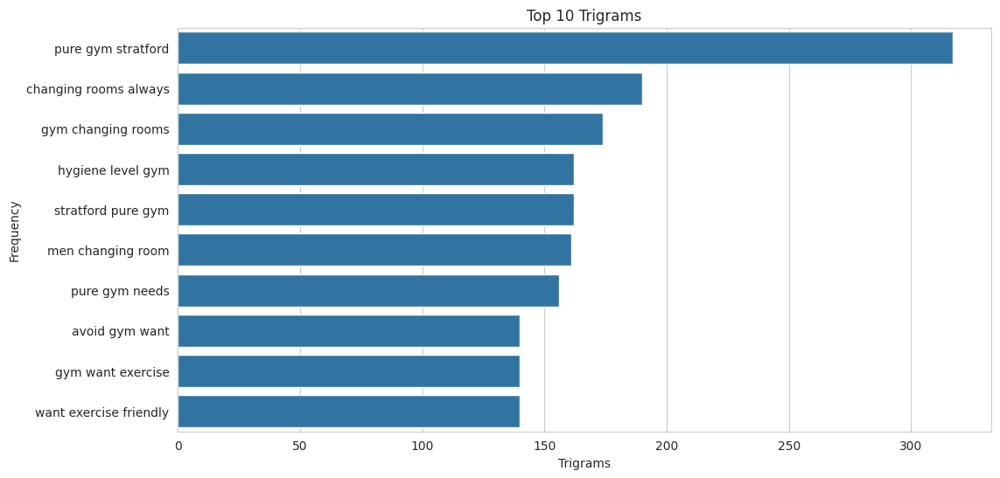

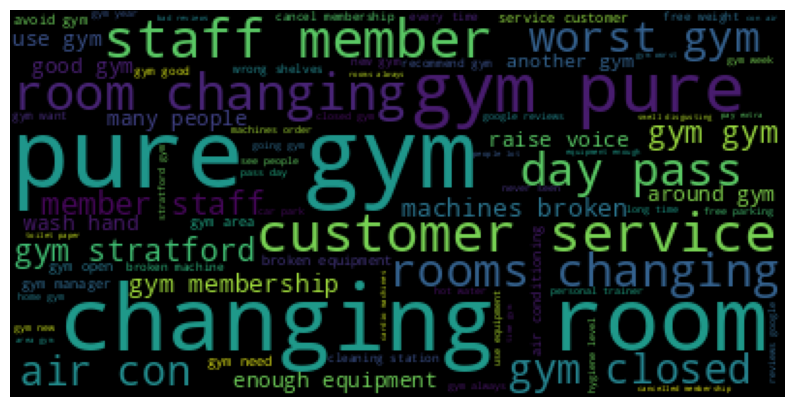

In [ ]:
# Wordcloud display for the reviews in the top 30 location with highest count of negative reviews from the merged data set
word_cloud_display(top_30_neg_locations_df,'All_Reviews')

In [ ]:
#Clean Data before running it in BERTopic
merged__reviews__in_top_30_neg_locations_list_clean = []
for review in merged__reviews__in_top_30_neg_locations_list:
  if review is not None and review != "nan":
    review = review.lower()
    review = re.sub('[^A-Za-z]+', ' ', review)

    word_tokens = word_tokenize(review)

    for w in word_tokens:
      if w in stop_words:
        review = review.replace(" " + w + " ", " ")
    merged__reviews__in_top_30_neg_locations_list_clean.append(review)

print(merged__reviews__in_top_30_neg_locations_list_clean[0:9])

['this gym way hot even workout windows open ac barely works staff near friendly always rude especially men clients doesnt mean dont work here', 'this gym way hot even workout windows open ac barely works staff near friendly always rude especially men clients doesnt mean dont work here', 'this gym way hot even workout windows open ac barely works staff near friendly always rude especially men clients doesnt mean dont work here', 'this gym way hot even workout windows open ac barely works staff near friendly always rude especially men clients doesnt mean dont work here', 'this gym way hot even workout windows open ac barely works staff near friendly always rude especially men clients doesnt mean dont work here', 'this gym way hot even workout windows open ac barely works staff near friendly always rude especially men clients doesnt mean dont work here', 'this gym way hot even workout windows open ac barely works staff near friendly always rude especially men clients doesnt mean dont wor

## Berttopic

In [ ]:
model_1 = BERTopic(nr_topics="auto",verbose=True)
model_1.fit(merged__reviews__in_top_30_neg_locations_list_clean)
topic, probabilities = model_1.transform(merged__reviews__in_top_30_neg_locations_list_clean)

2025-04-20 17:41:33,573 - BERTopic - Embedding - Transforming documents to embeddings.


Batches:   0%|          | 0/458 [00:00<?, ?it/s]

2025-04-20 17:41:42,732 - BERTopic - Embedding - Completed ✓
2025-04-20 17:41:42,733 - BERTopic - Dimensionality - Fitting the dimensionality reduction algorithm
2025-04-20 17:42:03,803 - BERTopic - Dimensionality - Completed ✓
2025-04-20 17:42:03,804 - BERTopic - Cluster - Start clustering the reduced embeddings
2025-04-20 17:42:04,490 - BERTopic - Cluster - Completed ✓
2025-04-20 17:42:04,491 - BERTopic - Representation - Extracting topics using c-TF-IDF for topic reduction.
2025-04-20 17:42:05,275 - BERTopic - Representation - Completed ✓
2025-04-20 17:42:05,277 - BERTopic - Topic reduction - Reducing number of topics
2025-04-20 17:42:05,936 - BERTopic - Representation - Fine-tuning topics using representation models.
2025-04-20 17:42:06,344 - BERTopic - Representation - Completed ✓
2025-04-20 17:42:06,349 - BERTopic - Topic reduction - Reduced number of topics from 643 to 186


Batches:   0%|          | 0/458 [00:00<?, ?it/s]

2025-04-20 17:42:15,414 - BERTopic - Dimensionality - Reducing dimensionality of input embeddings.
2025-04-20 17:42:15,454 - BERTopic - Dimensionality - Completed ✓
2025-04-20 17:42:15,455 - BERTopic - Clustering - Approximating new points with `hdbscan_model`
2025-04-20 17:42:15,994 - BERTopic - Cluster - Completed ✓


In [ ]:
print(model_1.get_topic_info())

     Topic  Count                                  Name  \
0       -1    273    -1_obnoxious_management_fines_loud   
1        0  10646          0_gym_equipment_staff_people   
2        1     86        1_bottles_fill_alcohol_filling   
3        2     61        2_exercising_spend_you_waiting   
4        3     60  3_rowing_batteries_straps_interested   
..     ...    ...                                   ...   
181    180     12                  180_fooled_con_if_me   
182    181     12  181_answering_absolutel_bell_outside   
183    182     12      182_croweded_chance_very_evening   
184    183     12            183_dip_brushed_stiff_calf   
185    184     11     184_nobody_returns_annoying_right   

                                        Representation  \
0    [obnoxious, management, fines, loud, pts, voic...   
1    [gym, equipment, staff, people, members, pure,...   
2    [bottles, fill, alcohol, filling, wait, founta...   
3    [exercising, spend, you, waiting, parking, som...   
4

In [ ]:
model_1.get_topic_freq().head(20)

,Topic,Count
0,0,10646
1,-1,273
53,1,86
101,2,61
31,3,60
91,4,59
153,5,59
64,6,50
27,7,50
98,8,50


In [ ]:
model_1.visualize_topics()

In [ ]:
model_1.visualize_barchart()

In [ ]:
model_1.visualize_heatmap()

#### Commentary on the results:

Compared with the topic modelling for the combined bad reviews without filtering based on top 30 locations with negative reviews, this run of bertopic provided more fine grained clusters and less outliers. Compared with the previous topic modelling where clusters were less and more general.

Reasons for this include
- more diverse opinions on locations, with more unique wording which means less shared vocabulary and so harder for BERTopic to merge topics,



## Emotional Analysis

In [ ]:
classifier = pipeline("text-classification", model='bhadresh-savani/bert-base-uncased-emotion', return_all_scores=True, max_length=512, truncation=True)

config.json:   0%|          | 0.00/935 [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/438M [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/285 [00:00<?, ?B/s]

vocab.txt:   0%|          | 0.00/232k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/466k [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/112 [00:00<?, ?B/s]

Device set to use cuda:0


In [ ]:
test_prompt = "The showers were awful"

In [ ]:
emotion_labels = classifier(test_prompt)

In [ ]:
emotion_labels_sorted = sorted(emotion_labels[0], key=lambda x: x["score"], reverse=True)

In [ ]:
print(emotion_labels_sorted)

[{'label': 'sadness', 'score': 0.8031430244445801}, {'label': 'anger', 'score': 0.1828264743089676}, {'label': 'fear', 'score': 0.011557292193174362}, {'label': 'surprise', 'score': 0.000894435215741396}, {'label': 'joy', 'score': 0.0008299767505377531}, {'label': 'love', 'score': 0.0007488039555028081}]


In [ ]:
#Preprocessing funtion to clean and tokenize reviews:
def minimal_clean(df, key):
    return df[key].dropna().astype(str).str.replace(r'[^A-Za-z0-9\s.,!?]', '', regex=True).str.strip()

In [ ]:
# Negative reviews from both dataset
bad_reviews_google = google_df[google_df['Overall Score'] < 3]
bad_reviews_trustpilot = trustpilot_df[trustpilot_df['Review Stars'] < 3]
print(len(bad_reviews_google))
print(len(bad_reviews_trustpilot))

2422
2247


In [ ]:
# preprocess the negative reviews list
clean_bad_google_reviews = minimal_clean(bad_reviews_google, 'Comment')
clean_bad_trustpilot_reviews = minimal_clean(bad_reviews_trustpilot, 'Review Content')
print(len(clean_bad_google_reviews))
print(len(clean_bad_trustpilot_reviews))

2422
2247


In [ ]:
print(type(google_top_emotions))
print(type(trustpilot_top_emotions))
print(type(bad_google_reviews_emotion_labels))
print(type(bad_trustpilot_reviews_emotion_labels))

NameError: name 'google_top_emotions' is not defined

In [ ]:
print("Length of bad_reviews_google:", len(bad_reviews_google))
print("Length of google_top_emotions:", len(google_top_emotions))

print("Length of bad_reviews_trustpilot:", len(bad_reviews_trustpilot))
print("Length of trustpilot_top_emotions:", len(trustpilot_top_emotions))

Length of bad_reviews_google: 2422


NameError: name 'google_top_emotions' is not defined

In [ ]:
#Run classifier
bad_google_reviews_emotion_labels = classifier(list(clean_bad_google_reviews))
bad_trustpilot_reviews_emotion_labels = classifier(list(clean_bad_trustpilot_reviews))
print(len(bad_google_reviews_emotion_labels))
print(len(bad_trustpilot_reviews_emotion_labels))

2422
2247


In [ ]:
#Extract the top emotion function:
def get_top_emotions(emotion_results):
    return [max(review, key=lambda x: x["score"])["label"] for review in emotion_results]

#Extract top emotions from the negative reviews
google_top_emotions = get_top_emotions(bad_google_reviews_emotion_labels)
trustpilot_top_emotions = get_top_emotions(bad_trustpilot_reviews_emotion_labels)

print(len(google_top_emotions))
print(len(trustpilot_top_emotions))

2422
2247


In [ ]:
# Assign the "Top Emotion" column
bad_reviews_google["Top Emotion"] = google_top_emotions
bad_reviews_trustpilot["Top Emotion"] = trustpilot_top_emotions

Text(0.5, 1.0, 'Top Emotion Distribution in Google Negative Reviews')

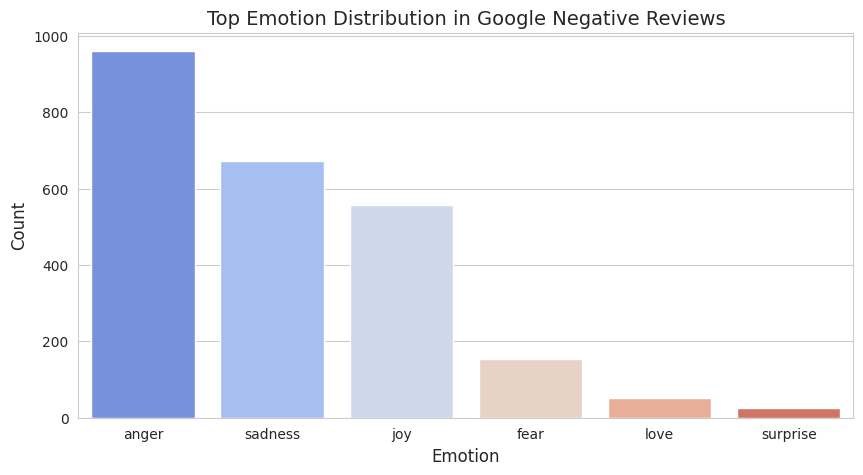

In [ ]:
# Count the occurrence of each emotion in Google Dataset
bad_reviews_google_emotion_counts = bad_reviews_google["Top Emotion"].value_counts()

# Plot barchart
plt.figure(figsize=(10, 5))
sns.barplot(x=bad_reviews_google_emotion_counts.index, y=bad_reviews_google_emotion_counts.values, palette="coolwarm")
plt.xlabel("Emotion", fontsize=12)
plt.ylabel("Count", fontsize=12)
plt.title("Top Emotion Distribution in Google Negative Reviews", fontsize=14)

Text(0.5, 1.0, 'Top Emotion Distribution in Trustpilot Negative Reviews')

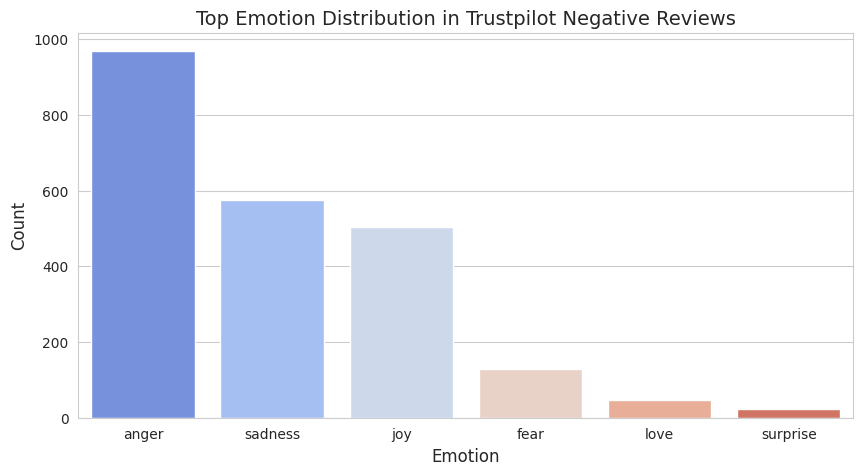

In [ ]:
# Count the occurrence of each emotion in Trustpilot Dataset
bad_reviews_trustpilot_emotion_counts = bad_reviews_trustpilot["Top Emotion"].value_counts()

# Plot barchart
plt.figure(figsize=(10, 5))
sns.barplot(x=bad_reviews_trustpilot_emotion_counts.index, y=bad_reviews_trustpilot_emotion_counts.values, palette="coolwarm")
plt.xlabel("Emotion", fontsize=12)
plt.ylabel("Count", fontsize=12)
plt.title("Top Emotion Distribution in Trustpilot Negative Reviews", fontsize=14)

In [ ]:
# filter the reviews with anger as the top emotion
angry_google_reviews = bad_reviews_google[bad_reviews_google["Top Emotion"] == "anger"]
angry_trustpilot_reviews = bad_reviews_trustpilot[bad_reviews_trustpilot["Top Emotion"] == "anger"]

In [ ]:
# Convert the Angry Google Review in the Comment column to a list
angry_google_reviews['Comment'] = angry_google_reviews['Comment'].astype(str)
angry_google_reviews_list = angry_google_reviews['Comment'].to_list()
print(angry_google_reviews_list[0:9])

['Too many students from two local colleges go her leave rubbish in changing rooms and sit there like there in a canteen Been going here for years will cancel my membership and go to gym group This gym is disgusting students hanging around machines and messing around like there at school Too over crowded And their ceo supports the genocide of civilians by Israel Disgusting people', 'This gym is way too hot to even workout in There are no windows open and the AC barely works The staff are no where near friendly they are always rude especially the men Just because you have clients doesnt mean you dont work here', 'The gym is huge but where is all the equipment They could easily fit in double the amount of equipment Expect the usual grumpy pure gym goers and facilities Shame at the lack of equipment as it has potential to actually be a half decent gym', 'Airconditioning doesnt work', 'My friend is new to the gym she had just joined and was struggling to get the scanner working to get in s

In [ ]:
# Convert the Angry Trustpilot Review to a list
angry_trustpilot_reviews['Review Content'] = angry_trustpilot_reviews['Review Content'].astype(str)
angry_trustpilot_reviews_list = angry_trustpilot_reviews['Review Content'].to_list()
print(angry_google_reviews_list[0:9])

['Too many students from two local colleges go her leave rubbish in changing rooms and sit there like there in a canteen Been going here for years will cancel my membership and go to gym group This gym is disgusting students hanging around machines and messing around like there at school Too over crowded And their ceo supports the genocide of civilians by Israel Disgusting people', 'This gym is way too hot to even workout in There are no windows open and the AC barely works The staff are no where near friendly they are always rude especially the men Just because you have clients doesnt mean you dont work here', 'The gym is huge but where is all the equipment They could easily fit in double the amount of equipment Expect the usual grumpy pure gym goers and facilities Shame at the lack of equipment as it has potential to actually be a half decent gym', 'Airconditioning doesnt work', 'My friend is new to the gym she had just joined and was struggling to get the scanner working to get in s

In [ ]:
#Combine the lists
angry_reviews = angry_google_reviews_list + angry_trustpilot_reviews_list

In [ ]:
print(len(angry_reviews))

1929


In [ ]:
from nltk.stem import WordNetLemmatizer

In [ ]:
#Clean Data before running it in BERTopic (keep stop words)

nltk.download('wordnet')

# Initialize Lemmatizer
lemmatizer = WordNetLemmatizer()

angry_reviews_list_clean = []
for review in angry_reviews:
  if review is not None and review != "nan":
    review = review.lower()
    review = re.sub('[^A-Za-z]+', ' ', review)

    stop_words = set(stopwords.words('english'))
    word_tokens = word_tokenize(review)

    cleaned_tokens = []
    for w in word_tokens:
      if w not in stop_words:
        lemmatized_word = lemmatizer.lemmatize(w)
        cleaned_tokens.append(lemmatized_word)

    cleaned_review = ' '.join(cleaned_tokens)
    angry_reviews_list_clean.append(cleaned_review)

print(angry_reviews_list_clean[-10:])

[nltk_data] Downloading package wordnet to /root/nltk_data...


['shower constantly cold', 'recommend management unprofessional full false promise especially come equipment fixed toilet use clearly flooded management run gym efficiently like school playground raise sort issue gym dislike reading previous review regarding member nathan helen shocked read experience never heard gym affecting people like safe say going elsewhere', 'enough equipment', 'waste money one chest bench press incline chest press lack many equipment ashton lyne gym joke', 'need periodic maintenance sport equipment providing dumbbell time busy general cleanliness place bathroom particular', 'always machine broken use enough equipment busy gym', 'recommend gym pt jelena rude member overheard talking badly female member since left gym management dealing instead simpler get rid member member made complaint jelena rightly gym turned around onto member despite witness jelena extremely rude member brought tear disgraceful', 'gone since restarted membership give second chance location

In [ ]:
model_2 = BERTopic(nr_topics="auto",verbose=True)
model_2.fit(angry_reviews_list_clean)
topic, probabilities = model_2.transform(angry_reviews_list_clean)

2025-04-20 19:09:08,967 - BERTopic - Embedding - Transforming documents to embeddings.


Batches:   0%|          | 0/61 [00:00<?, ?it/s]

2025-04-20 19:09:11,057 - BERTopic - Embedding - Completed ✓
2025-04-20 19:09:11,059 - BERTopic - Dimensionality - Fitting the dimensionality reduction algorithm
2025-04-20 19:09:17,809 - BERTopic - Dimensionality - Completed ✓
2025-04-20 19:09:17,810 - BERTopic - Cluster - Start clustering the reduced embeddings
2025-04-20 19:09:17,871 - BERTopic - Cluster - Completed ✓
2025-04-20 19:09:17,872 - BERTopic - Representation - Extracting topics using c-TF-IDF for topic reduction.
2025-04-20 19:09:17,957 - BERTopic - Representation - Completed ✓
2025-04-20 19:09:17,958 - BERTopic - Topic reduction - Reducing number of topics
2025-04-20 19:09:17,967 - BERTopic - Representation - Fine-tuning topics using representation models.
2025-04-20 19:09:18,038 - BERTopic - Representation - Completed ✓
2025-04-20 19:09:18,040 - BERTopic - Topic reduction - Reduced number of topics from 29 to 29


Batches:   0%|          | 0/61 [00:00<?, ?it/s]

2025-04-20 19:09:19,232 - BERTopic - Dimensionality - Reducing dimensionality of input embeddings.
2025-04-20 19:09:19,240 - BERTopic - Dimensionality - Completed ✓
2025-04-20 19:09:19,241 - BERTopic - Clustering - Approximating new points with `hdbscan_model`
2025-04-20 19:09:19,290 - BERTopic - Cluster - Completed ✓


In [ ]:
model_2.get_topic_freq().head(10)

,Topic,Count
0,-1,660
2,0,175
6,1,148
1,2,134
19,3,93
18,4,63
5,5,59
8,6,58
3,7,57
9,8,51


In [ ]:
model_2.visualize_topics()

In [ ]:
model_2.visualize_barchart()

Commentary on the results:

Compared to the initial investigation, we now have fewer topics—27 in total. This is expected, as the emotion analysis focuses on a smaller subset of the data: reviews expressing anger.

When we first ran BERTopic on this subset, the clustering didn’t perform well and resulted in a high number of outliers. To improve the results, we had to lemmatize the review text before inputting it into BERTopic, which helped the model group similar content more effectively.


It’s worth noting that the topics identified here are very similar to those we saw when running BERTopic on all negative reviews. It’ll be interesting to explore how language choice linked to emotion—specifically anger—impacts topic formation.

The topics such as staff behaviour, membership issues, equiment maintenaince, access issues and class cancellations have all been highlighted before

## Using a large language model from Hugging Face

In [ ]:
import json

In [ ]:
import torch
from transformers import AutoModelForCausalLM, AutoTokenizer, pipeline

In [ ]:
torch.manual_seed(0)

In [ ]:
model = AutoModelForCausalLM.from_pretrained(
    "microsoft/Phi-4-mini-instruct",
    device_map="cuda",
    torch_dtype="auto",
    trust_remote_code=True,
)
tokenizer = AutoTokenizer.from_pretrained("microsoft/Phi-4-mini-instruct")

/usr/local/lib/python3.11/dist-packages/huggingface_hub/utils/_auth.py:94: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


config.json:   0%|          | 0.00/2.50k [00:00<?, ?B/s]

configuration_phi3.py:   0%|          | 0.00/10.9k [00:00<?, ?B/s]

A new version of the following files was downloaded from https://huggingface.co/microsoft/Phi-4-mini-instruct:
- configuration_phi3.py
. Make sure to double-check they do not contain any added malicious code. To avoid downloading new versions of the code file, you can pin a revision.


modeling_phi3.py:   0%|          | 0.00/54.3k [00:00<?, ?B/s]

A new version of the following files was downloaded from https://huggingface.co/microsoft/Phi-4-mini-instruct:
- modeling_phi3.py
. Make sure to double-check they do not contain any added malicious code. To avoid downloading new versions of the code file, you can pin a revision.


model.safetensors.index.json:   0%|          | 0.00/16.3k [00:00<?, ?B/s]

Fetching 2 files:   0%|          | 0/2 [00:00<?, ?it/s]

model-00001-of-00002.safetensors:   0%|          | 0.00/4.90G [00:00<?, ?B/s]

model-00002-of-00002.safetensors:   0%|          | 0.00/2.77G [00:00<?, ?B/s]

Loading checkpoint shards:   0%|          | 0/2 [00:00<?, ?it/s]

generation_config.json:   0%|          | 0.00/168 [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/2.93k [00:00<?, ?B/s]

vocab.json:   0%|          | 0.00/3.91M [00:00<?, ?B/s]

merges.txt:   0%|          | 0.00/2.42M [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/15.5M [00:00<?, ?B/s]

added_tokens.json:   0%|          | 0.00/249 [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/587 [00:00<?, ?B/s]

In [ ]:
pipe = pipeline(
    "text-generation",
    model=model,
    tokenizer=tokenizer,
)

Device set to use cuda


In [ ]:
generation_args = {
    "max_new_tokens": 500,
    "return_full_text": False,
    "temperature": 0.0,
    "do_sample": False,
}

In [ ]:
prompt_0 = [
    {"role": "system", "content": "You work as a data analyst for a large gym company and you want to find topics for improvments from customer reviews. You should return these in an array of strings only ['topic 1', 'topic 2', 'topic 3', ...]"},
    {"role": "user", "content": "In the following bad reviews list extractedcustomer review list, pick out a maximum of 3 main topics and return them as an array of topics: Too many students from two local colleges go her leave rubbish in changing rooms"},
    {"role": "assistant", "content": "['AC barely works', 'staff are rude', 'overcrowded gym']"},
    {"role": "user", "content": "In the following customer review interaction pick out the main  topics and return them as an array of topics: current member Gym is quite dirty more often than not theres no soap in the bathroom There is zero airflow in the gym its like a sauna in here Also the gym is often overcrowded anytime after pm The only good thing about this gym is the location and the bring your buddy thing"},
]

In [ ]:
output = pipe(prompt_0, **generation_args)

/usr/local/lib/python3.11/dist-packages/transformers/generation/configuration_utils.py:631: UserWarning: `do_sample` is set to `False`. However, `temperature` is set to `0.0` -- this flag is only used in sample-based generation modes. You should set `do_sample=True` or unset `temperature`.
  warnings.warn(


In [ ]:
topic_list_string = output[0]['generated_text'].replace("'", '"')
print(topic_list_string)

["Cleanliness", "Airflow", "Overcrowding", "Location", "Bring your buddy program"]


In [ ]:
topic_list = json.loads(topic_list_string)
print(topic_list)

['Cleanliness', 'Airflow', 'Overcrowding', 'Location', 'Bring your buddy program']


In [ ]:
# Negative reviews from the datasets
bad_reviews_google = google_df[google_df['Overall Score'] < 3]
bad_reviews_trustpilot = trustpilot_df[trustpilot_df['Review Stars'] < 3]

In [ ]:
bad_reviews_google_list = bad_reviews_google['Comment'].to_list()
bad_reviews_trustedpilot_list = bad_reviews_trustpilot['Review Content'].to_list()

bad_reviews_list = bad_reviews_google_list + bad_reviews_trustedpilot_list

In [ ]:
print(bad_reviews_list)

['Too many students from two local colleges go her leave rubbish in changing rooms and sit there like there in a canteen Been going here for years will cancel my membership and go to gym group This gym is disgusting students hanging around machines and messing around like there at school Too over crowded And their ceo supports the genocide of civilians by Israel Disgusting people', 'current member Gym is quite dirty more often than not theres no soap in the bathroom There is zero airflow in the gym its like a sauna in here Also the gym is often overcrowded anytime after pm The only good thing about this gym is the location and the bring your buddy thing', 'This gym is way too hot to even workout in There are no windows open and the AC barely works The staff are no where near friendly they are always rude especially the men Just because you have clients doesnt mean you dont work here', 'No access for wc Empty and no assistance to gain access my fault as forgot my pin but didnt see stay 

In [ ]:
bad_reviews_list_clean = []
for review in bad_reviews_list:
  if review is not None:
    bad_reviews_list_clean.append(review)

In [ ]:
len(bad_reviews_list_clean)

4664

In [ ]:
print(bad_reviews_list_clean)

['Too many students from two local colleges go her leave rubbish in changing rooms and sit there like there in a canteen Been going here for years will cancel my membership and go to gym group This gym is disgusting students hanging around machines and messing around like there at school Too over crowded And their ceo supports the genocide of civilians by Israel Disgusting people', 'current member Gym is quite dirty more often than not theres no soap in the bathroom There is zero airflow in the gym its like a sauna in here Also the gym is often overcrowded anytime after pm The only good thing about this gym is the location and the bring your buddy thing', 'This gym is way too hot to even workout in There are no windows open and the AC barely works The staff are no where near friendly they are always rude especially the men Just because you have clients doesnt mean you dont work here', 'No access for wc Empty and no assistance to gain access my fault as forgot my pin but didnt see stay 

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
topics_llm = []
iter=0
for idx, review in enumerate(bad_reviews_list_clean[0:100]):
  if len(str(review)) < 1000:
        prompt_1 = [
    {"role": "system", "content": "You work as a data analyst for a large gym company, Your task is to find key topics from each customer review.You should return these in an array of strings only like ['topic 1', 'topic 2', 'topic 3', ...]"},
    {"role": "user", "content": "In the following customer review, pick out a maximum of 3 main topics and return them as an array of topics: Too many students from two local colleges go here, leave rubbish in changing rooms and sit there like they're in a canteen. Been going here for years, will cancel my membership and go to Gym Group. This gym is disgusting, students hanging around machines and messing around like they're at school. Too overcrowded. And their CEO supports the genocide of civilians by Israel. Disgusting people"},
    {"role": "assistant", "content": "['Dirty Changing rooms', 'disruptive student behaviour', 'overcrowded gym','Customer disagreement with CEO’s political stance']"},
    {"role": "user", "content": f"In the following customer review, pick out a maximum of 3 key topics. Return these in an array of strings only like ['topic 1', 'topic 2', 'topic 3', ...]: {review}"},
]

        # Run the model
        output = pipe(prompt_1, **generation_args)

        # Get the output string and convert to a list
        topic_list_string = output[0]['generated_text'].strip()
        topic_list_string = topic_list_string.strip("[]").replace("'", '"')
        topic_list = json.loads(f"[{topic_list_string}]")
        numbered_topic_list = [f"{i+1}. {topic}" for i, topic in enumerate(topic_list)]
        topics_llm.append(topic_list)
        print(f"\nReview {idx+1}:\n{numbered_topic_list}")

# Convert and save the topics
if topics_llm:
    np_topics_llm = np.array(topics_llm, dtype=object)
    np.save('/content/drive/MyDrive/np_topics_phi.npy', np_topics_llm)
else:
    print("\n No valid topics extracted.")


Review 1:
['1. Overcrowded gym', '2. Dirty changing rooms', '3. Disruptive student behaviour', '4. Customer disagreement with CEO’s political stance']

Review 2:
['1. Dirty gym', '2. lack of ventilation', '3. overcrowded gym', '4. positive aspects: location and buddy system']

Review 3:
['1. Uncomfortable temperature', '2. poor air conditioning', '3. unfriendly staff']

Review 4:
['1. Access issues', '2. Forgot pin', '3. Lack of assistance']

Review 5:
['1. Overcrowded gym', '2. Lack of equipment', '3. Uncomfortable temperature']

Review 6:
['1. Lack of equipment', '2. large gym space', '3. poor facilities']

Review 7:
['1. Air conditioning issues']

Review 8:
['1. Scanner issues', '2. rude behaviour', '3. poor hygiene']


You seem to be using the pipelines sequentially on GPU. In order to maximize efficiency please use a dataset



Review 9:
['1. Hygiene', '2. rude staff', '3. unhappy with gym services']

Review 10:
['1. Uncooperative gym members', '2. Disruptive behaviour', '3. Potential for conflict']

Review 11:
['1. Small gym space', '2. inadequate staff management', '3. influencer filming']

Review 12:
['1. Poor maintenance', '2. Lack of management', '3. Unprofessional staff behaviour']

Review 13:
['1. Overcrowded gym', '2. Workout time inconvenient', '3. Difficulty working out']

Review 14:
['1. Space', '2. Equipment', '3. Facility size']

Review 15:
['1. Cancellation policy', '2. Unavailability of classes', '3. Need for better gym options']

Review 16:
['1. Locked windows', '2. poor air quality', '3. lack of free WiFi']

Review 17:
['1. Gym staff behaviour', '2. Customer dissatisfaction with staff', '3. Personal clothing choices']

Review 18:
['1. Unclean facilities', '2. COVID-19 safety concerns', '3. Inconsistent gym hours', '4. Poor customer service', '5. Lack of amenities', '6. Health and hygiene iss

In [ ]:
loaded_arr = np.load('/content/drive/MyDrive/np_topics_phi.npy', allow_pickle=True)
topics_llm = loaded_arr.tolist()

In [ ]:
print(topics_llm)

[['Overcrowded gym', 'Dirty changing rooms', 'Disruptive student behaviour', 'Customer disagreement with CEO’s political stance'], ['Dirty gym', 'lack of ventilation', 'overcrowded gym', 'positive aspects: location and buddy system'], ['Uncomfortable temperature', 'poor air conditioning', 'unfriendly staff'], ['Access issues', 'Forgot pin', 'Lack of assistance'], ['Overcrowded gym', 'Lack of equipment', 'Uncomfortable temperature'], ['Lack of equipment', 'large gym space', 'poor facilities'], ['Air conditioning issues'], ['Scanner issues', 'rude behaviour', 'poor hygiene'], ['Hygiene', 'rude staff', 'unhappy with gym services'], ['Uncooperative gym members', 'Disruptive behaviour', 'Potential for conflict'], ['Small gym space', 'inadequate staff management', 'influencer filming'], ['Poor maintenance', 'Lack of management', 'Unprofessional staff behaviour'], ['Overcrowded gym', 'Workout time inconvenient', 'Difficulty working out'], ['Space', 'Equipment', 'Facility size'], ['Cancellatio

In [ ]:
topic_string_array = [item for row in topics_llm for item in row]

In [ ]:
topic_string_array

['Overcrowded gym',
 'Dirty changing rooms',
 'Disruptive student behaviour',
 'Customer disagreement with CEO’s political stance',
 'Dirty gym',
 'lack of ventilation',
 'overcrowded gym',
 'positive aspects: location and buddy system',
 'Uncomfortable temperature',
 'poor air conditioning',
 'unfriendly staff',
 'Access issues',
 'Forgot pin',
 'Lack of assistance',
 'Overcrowded gym',
 'Lack of equipment',
 'Uncomfortable temperature',
 'Lack of equipment',
 'large gym space',
 'poor facilities',
 'Air conditioning issues',
 'Scanner issues',
 'rude behaviour',
 'poor hygiene',
 'Hygiene',
 'rude staff',
 'unhappy with gym services',
 'Uncooperative gym members',
 'Disruptive behaviour',
 'Potential for conflict',
 'Small gym space',
 'inadequate staff management',
 'influencer filming',
 'Poor maintenance',
 'Lack of management',
 'Unprofessional staff behaviour',
 'Overcrowded gym',
 'Workout time inconvenient',
 'Difficulty working out',
 'Space',
 'Equipment',
 'Facility size',


In [ ]:
print(len(topic_string_array))

293


In [ ]:
# Find unique topics in topic_string_array
unique_topics = set(topic_string_array)
print(unique_topics)

#number of unique topics
unique = len(unique_topics)
print(unique)

{'Locker break-in', 'Busy during rush hour', 'Unsafe environment', 'Lack of focus on gym services', 'First-time visit', 'Space', 'dirty changing rooms', 'unfriendly staff', 'Poor equipment maintenance', 'Staff misconduct', 'Shower cleanliness', 'Underage teens', 'Wet machines', 'Off peak hour class cancellation', 'Inappropriate workout session', 'Gym closure due to leak', 'Unprofessional behaviour of Personal Trainer', 'Busy gym', 'influencer filming', 'Access issues with PIN', 'Health and hygiene issues', 'Good equipment', 'Inappropriate use of gym equipment', 'Inconsistent gym hours', 'Need for better gym options', 'stabbing incident', 'Unprofessional trainer behavior', 'Broken and rusty equipment', 'poor gym etiquette', 'Poor layout and equipment', 'Lack of cleaning supplies', 'Inconsistent staff availability', 'Unavailability of classes', 'Unclean equipment', 'Poor ventilation', 'Limited availability of machines and classes', 'poor social atmosphere', 'lack of hygiene supplies', 'd

In [ ]:
#convert unique topics to a list:
unique_topics_list = list(unique_topics)

Bertopic

In [ ]:
model = BERTopic(verbose=True)
model.fit(topic_string_array)
topic, probabilities = model.transform(topic_string_array)

2025-04-19 12:16:56,041 - BERTopic - Embedding - Transforming documents to embeddings.


modules.json:   0%|          | 0.00/349 [00:00<?, ?B/s]

config_sentence_transformers.json:   0%|          | 0.00/116 [00:00<?, ?B/s]

README.md:   0%|          | 0.00/10.5k [00:00<?, ?B/s]

sentence_bert_config.json:   0%|          | 0.00/53.0 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/612 [00:00<?, ?B/s]

Xet Storage is enabled for this repo, but the 'hf_xet' package is not installed. Falling back to regular HTTP download. For better performance, install the package with: `pip install huggingface_hub[hf_xet]` or `pip install hf_xet`


model.safetensors:   0%|          | 0.00/90.9M [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/350 [00:00<?, ?B/s]

vocab.txt:   0%|          | 0.00/232k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/466k [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/112 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/190 [00:00<?, ?B/s]

Batches:   0%|          | 0/10 [00:00<?, ?it/s]

2025-04-19 12:17:10,850 - BERTopic - Embedding - Completed ✓
2025-04-19 12:17:10,852 - BERTopic - Dimensionality - Fitting the dimensionality reduction algorithm
2025-04-19 12:17:19,839 - BERTopic - Dimensionality - Completed ✓
2025-04-19 12:17:19,841 - BERTopic - Cluster - Start clustering the reduced embeddings
2025-04-19 12:17:19,856 - BERTopic - Cluster - Completed ✓
2025-04-19 12:17:19,874 - BERTopic - Representation - Fine-tuning topics using representation models.
2025-04-19 12:17:19,908 - BERTopic - Representation - Completed ✓


Batches:   0%|          | 0/10 [00:00<?, ?it/s]

2025-04-19 12:17:20,045 - BERTopic - Dimensionality - Reducing dimensionality of input embeddings.
2025-04-19 12:17:20,047 - BERTopic - Dimensionality - Completed ✓
2025-04-19 12:17:20,049 - BERTopic - Clustering - Approximating new points with `hdbscan_model`
2025-04-19 12:17:20,057 - BERTopic - Cluster - Completed ✓


In [ ]:
model.get_topic_freq().head(10)

,Topic,Count
5,0,83
1,-1,56
2,1,32
8,2,25
7,3,25
3,4,24
0,5,17
6,6,17
4,7,12


In [ ]:
model.visualize_topics()

In [ ]:
model.visualize_barchart()

Comment: Bertopic clusters the topics well in 7 distinct topics utilising the topics identified from each review by hugging face. However we must bear in mind that i only ran the first prompt on the first 100 negative reviews and not the entire list compared to the previous initial investigation and further investigation sections where  all the reviews were ran on Bertopic.



In [ ]:
topics = model.get_topics()

In [ ]:
print(topics)

{-1: [('dirty', np.float64(0.16111495716713292)), ('maintenance', np.float64(0.13378880508677124)), ('uncomfortable', np.float64(0.12096864623529135)), ('temperature', np.float64(0.12096864623529135)), ('rooms', np.float64(0.10707506824218627)), ('changing', np.float64(0.10707506824218627)), ('facilities', np.float64(0.09666897430027976)), ('membership', np.float64(0.09186292356301796)), ('music', np.float64(0.09186292356301796)), ('poor', np.float64(0.08589504634599261))], 0: [('gym', np.float64(0.12206411229171493)), ('small', np.float64(0.06916628791278363)), ('workout', np.float64(0.06253850767635817)), ('for', np.float64(0.05830537506538886)), ('space', np.float64(0.05535578999690384)), ('with', np.float64(0.04940449136627402)), ('hour', np.float64(0.04749139821937155)), ('busy', np.float64(0.04749139821937155)), ('safety', np.float64(0.04749139821937155)), ('overcrowding', np.float64(0.03875293911374638))], 1: [('staff', np.float64(0.3843908401390793)), ('behaviour', np.float64(0

In [ ]:
print(unique)

Compared to the emptional analysis, further investigation and Initial investigation where we used BERT topic for topic modelling, t:

  berttopic has clustered well with only 7 topics and very few outliers,

Group topic under a single category

Actionable Insights

In [ ]:
prompt_2 = [
            {"role": "system", "content": "You work as a data analyst for a large gym company."},
           {"role": "user", "content": f"""In the following list of topics, group all semantically similar topics under a single broader category, such as 'staff', 'equipment', 'maintenance', etc. For each group, provide a maximum of 10 actionable insights in a numbered list format:
            Topics: {unique_topics_list}"""},
            {"role": "assistant", "content": """1. Staff:
              - Actionable insight: Implement a comprehensive staff training program focusing on customer service.
              - Actionable insight: Improve staff professionalism by setting clear behavior expectations.
              - Actionable insight: Conduct regular staff performance evaluations to ensure consistent service quality.
            2. Equipment:
              - Actionable insight: Regularly maintain gym equipment and replace outdated machines.
              - Actionable insight: Implement an equipment usage schedule to avoid overuse and breakdowns.
              - Actionable insight: Ensure all equipment is cleaned regularly to maintain hygiene and functionality.
            3. Maintenance:
              - Actionable insight: Set up a routine inspection schedule to detect and fix any maintenance issues early.
              - Actionable insight: Improve maintenance staff response time to customer complaints.
              - Actionable insight: Invest in preventative maintenance tools to reduce unexpected breakdowns."""},
            {"role": "user", "content": f"""In the following customer review, group or compress the topics into a maximum of 10 actionable insights in a numbered list format:
            Topics: {unique_topics_list}"""}]


In [ ]:
# List to store the extracted insights to topics
actionable_insights_llm = []

# Run the model
output = pipe(prompt_2, **generation_args)

# Check output
if not output or 'generated_text' not in output[0]:
    print("Empty or invalid response, skipping...")
else:
    raw_output = output[0]['generated_text'].strip()
    print(f"\n Raw output:\n{raw_output}\n")

    # Extract insights using regex
    pattern = r"\d+\.\s+.+?(?=\n\d+\.|\Z)"
    matches = re.findall(pattern, raw_output, re.DOTALL)

    if matches:
        insights = [match.strip().replace("\n", " ") for match in matches]
        actionable_insights_llm.append(insights)
    else:
        print("No valid insights found.")

# Save the actionable insights
if actionable_insights_llm:
    np_insights_llm = np.array(actionable_insights_llm, dtype=object)
    np.save('/content/drive/MyDrive/np_actionable_insights_phi.npy', np_insights_llm)
else:
    print("\nPlease check the model's output format.")


 Raw output:
1. Safety and Security:
              - Actionable insight: Install security cameras in locker areas and common spaces.
              - Actionable insight: Implement a strict locker security policy and provide lockers with combination locks.
              - Actionable insight: Increase security personnel presence during peak hours and in areas with previous incidents.
2. Equipment and Maintenance:
              - Actionable insight: Schedule regular maintenance checks for all gym equipment.
              - Actionable insight: Replace broken and rusty equipment promptly to ensure safety and functionality.
              - Actionable insight: Provide adequate cleaning supplies and assign staff to clean equipment after each use.
3. Staff Training and Behavior:
              - Actionable insight: Conduct regular staff training on customer service and conflict resolution.
              - Actionable insight: Establish a code of conduct for staff and enforce it consistently.
    

In [ ]:
loaded_arr_1 = np.load('/content/drive/MyDrive/np_actionable_insights_phi.npy', allow_pickle=True)
actionable_insights_llm = loaded_arr_1.tolist()

## Using Gensim

In [ ]:
pip install numpy==1.24.3 scipy==1.10.1

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 58.9/58.9 kB 1.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 17.3/17.3 MB 23.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 34.1/34.1 MB 16.1 MB/s eta 0:00:00
  Attempting uninstall: numpy
    Found existing installation: numpy 2.0.2
    Uninstalling numpy-2.0.2:
      Successfully uninstalled numpy-2.0.2
  Attempting uninstall: scipy
    Found existing installation: scipy 1.14.1
    Uninstalling scipy-1.14.1:
      Successfully uninstalled scipy-1.14.1
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
jaxlib 0.5.1 requires numpy>=1.25, but you have numpy 1.24.3 which is incompatible.
jaxlib 0.5.1 requires scipy>=1.11.1, but you have scipy 1.10.1 which is incompatible.
cvxpy 1.6.5 requires scipy>=1.11.0, but you have scipy 1.10.1 which is incompatible.
tensorflow 2.18.0 requires numpy<

In [ ]:
import numpy as np
import scipy

print("numpy version:", np.__version__)
print("scipy version:", scipy.__version__)

numpy version: 1.24.3
scipy version: 1.10.1


In [ ]:
! pip install gensim

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 26.7/26.7 MB 93.2 MB/s eta 0:00:00


In [ ]:
import gensim

In [ ]:
#Import Libraries and Packages
import pandas as pd
import matplotlib.pyplot as plt
import pandas as pd
import seaborn as sns

from wordcloud import WordCloud, STOPWORDS
import nltk
from nltk.corpus import stopwords
nltk.download('stopwords')
nltk.download('punkt')
nltk.download('punkt_tab')

from nltk.tokenize import word_tokenize
from nltk.tokenize import RegexpTokenizer

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.
[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt.zip.
[nltk_data] Downloading package punkt_tab to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt_tab.zip.


In [ ]:
from nltk.stem import WordNetLemmatizer
nltk.download('wordnet')

[nltk_data] Downloading package wordnet to /root/nltk_data...


True

In [ ]:
#Preprocessing funtion to clean and tokenize reviews:
def clean(df, key):
    stop_words = set(stopwords.words('english'))
    lemmatizer = WordNetLemmatizer()
    cleaned_reviews = []

    for review in df[key].dropna():
        review = review.lower()
        review = re.sub(r'[^A-Za-z\s]', ' ', review)
        tokens = word_tokenize(review)
        filtered = [lemmatizer.lemmatize(w) for w in tokens if w not in stop_words and len(w) > 2 and not w.isnumeric()]
        cleaned_reviews.append(filtered)

    return cleaned_reviews

In [ ]:
# Negative reviews from the datasets
bad_reviews_google = google_df[google_df['Overall Score'] < 3]
bad_reviews_trustpilot = trustpilot_df[trustpilot_df['Review Stars'] < 3]

In [ ]:
# preprocess the combined negative reviews list
clean_bad_google_reviews = clean(bad_reviews_google, 'Comment')
clean_bad_trustpilot_reviews = clean(bad_reviews_trustpilot, 'Review Content')

combined_bad_reviews = clean_bad_google_reviews + clean_bad_trustpilot_reviews

print(f"combined_bad_reviews: {combined_bad_reviews}")

combined_bad_reviews: [['many', 'student', 'two', 'local', 'college', 'leave', 'rubbish', 'changing', 'room', 'sit', 'like', 'canteen', 'going', 'year', 'cancel', 'membership', 'gym', 'group', 'gym', 'disgusting', 'student', 'hanging', 'around', 'machine', 'messing', 'around', 'like', 'school', 'crowded', 'ceo', 'support', 'genocide', 'civilian', 'israel', 'disgusting', 'people'], ['current', 'member', 'gym', 'quite', 'dirty', 'often', 'there', 'soap', 'bathroom', 'zero', 'airflow', 'gym', 'like', 'sauna', 'also', 'gym', 'often', 'overcrowded', 'anytime', 'good', 'thing', 'gym', 'location', 'bring', 'buddy', 'thing'], ['gym', 'way', 'hot', 'even', 'workout', 'window', 'open', 'barely', 'work', 'staff', 'near', 'friendly', 'always', 'rude', 'especially', 'men', 'client', 'doesnt', 'mean', 'dont', 'work'], ['access', 'empty', 'assistance', 'gain', 'access', 'fault', 'forgot', 'pin', 'didnt', 'see', 'stay', 'enable', 'assistance'], ['gym', 'year', 'finally', 'leaving', 'gutted', 'staff', 

In [ ]:
from gensim import corpora

#create dictionary representation of the words
dictionary = corpora.Dictionary(combined_bad_reviews)
dictionary.filter_extremes(no_below=2, no_above=0.5)

In [ ]:
#create Bow representation
corpus = [dictionary.doc2bow(review) for review in combined_bad_reviews]

#set parameters
num_topics = 10
passes= 20

In [ ]:
# Create the LDA Model
from gensim.models import LdaModel
lda_model = LdaModel(corpus=corpus, id2word=dictionary, num_topics=num_topics, passes=passes)

In [ ]:
# Print the topics.
for idx, topic in lda_model.print_topics(-1):
    print("Topic: {} \nWords: {}".format(idx, topic))

Topic: 0 
Words: 0.100*"class" + 0.024*"music" + 0.020*"instructor" + 0.012*"loud" + 0.012*"time" + 0.010*"good" + 0.009*"spin" + 0.009*"cancelled" + 0.009*"people" + 0.008*"work"
Topic: 1 
Words: 0.049*"equipment" + 0.020*"weight" + 0.019*"people" + 0.017*"bench" + 0.016*"place" + 0.014*"machine" + 0.014*"enough" + 0.014*"locker" + 0.013*"busy" + 0.013*"time"
Topic: 2 
Words: 0.031*"manager" + 0.023*"member" + 0.022*"said" + 0.022*"away" + 0.018*"weight" + 0.016*"put" + 0.016*"staff" + 0.011*"left" + 0.011*"rude" + 0.010*"bag"
Topic: 3 
Words: 0.019*"get" + 0.017*"day" + 0.013*"access" + 0.013*"membership" + 0.012*"staff" + 0.012*"email" + 0.011*"pas" + 0.010*"work" + 0.010*"member" + 0.009*"service"
Topic: 4 
Words: 0.052*"air" + 0.019*"conditioning" + 0.019*"con" + 0.014*"hot" + 0.012*"issue" + 0.010*"pure" + 0.009*"temperature" + 0.009*"please" + 0.008*"poor" + 0.008*"manager"
Topic: 5 
Words: 0.033*"shower" + 0.020*"toilet" + 0.019*"room" + 0.018*"changing" + 0.016*"water" + 0.013

In [ ]:
!pip install datasets pyLDAvis --quiet

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 491.2/491.2 kB 16.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.6/2.6 MB 71.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 116.3/116.3 kB 11.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 183.9/183.9 kB 18.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 143.5/143.5 kB 15.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 194.8/194.8 kB 17.7 MB/s eta 0:00:00
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
gcsfs 2025.3.2 requires fsspec==2025.3.2, but you have fsspec 2024.12.0 which is incompatible.
torch 2.6.0+cu124 requires nvidia-cublas-cu12==12.4.5.8; platform_system == "Linux" and platform_machine == "x86_64", but you have nvidia-cublas-cu12 12.5.3.2 which is incompatible.
torch 2.6.0+cu124 requires nvidia-cuda-cupti-cu12==12.4.127; platf

In [ ]:
#prepare visualisations
import pyLDAvis
import pyLDAvis.gensim_models as gensimvis
pyLDAvis.enable_notebook()
vis = gensimvis.prepare(lda_model, corpus, dictionary)
pyLDAvis.display(vis)

### Commentary on results from LDA Model

The Intertopic Distance Map displays the 10 clusters we predefined in the LDA model. For each cluster, we examined the top 30 most salient terms to interpret the dominant themes.

Cluster 8: The terms most frequent in cluster 8  are related with temperature air and airconditioning,

Cluster 3, 9 & 6: are closely clustered around similar regarding membership and access

Cluster 10: is related to interations with terms such as manger, rude said etc

eClusters 1, 2, and 4: These clusters are linked by themes related to gym infrastructure, with salient terms like equipment, machines, and showers. The reviews highlight issues with maintenanc&  cleanliness of facilities.

Cluster 5: This topic is centered around time and staff, suggesting concerns regarding scheduling, and  staff availability

cluster 7: the most salient terms in this cluster is class, music, loud

The topics picked up by the LDA model were mostly in line with what we saw using BERTopic in the initial analysis of negative reviews, and later with the topics from Microsoft Phi LLM.

While LDA doesn’t give us direct, actionable insights like Microsoft Phi LLM, it does help surface the same key themes that showed up in BERTopic.

Some of the main recurring issues across all methods were:

Hygiene

Staff behaviour

Membership problems

Equipment maintenance




## Conclusions:

-	All the techniques utilised for topic modelling were useful in highlighting the key themes in the negative reviews and provided similar topics.
-	The most highlighted themes a were staff behaviour, equipment maintenance, cleanliness, class scheduling/cancellations, ventilation, overcrowding and membership issues
-	The Microsoft phi LLm was the most useful as it was able to not only group the topics but provided actionable insights.
-	Emotional analysis on the negative reviews did not provide much insight but further emphasised on the topics Bertopic had extracted in the initial investigation
-	In our investigation
-	Top 30 locations with negative reviews table  showw that certain gyms are more prone to negative reviews then others and have high negative reviews from both platforms.


## Evaluations

-	For more nuances, review individual gyms that had a high count of negative reviews, and see the distribution of the negative reviews that came from the same gym, so that customer feedback from one geographic area is not generalised to all gyms
-	Check the review date for the customer reviews, to understand temporal context did the bulk of the reviews happen around the same time (due to a temporary issue) or is this a unresolved problem.
